In [1]:
import cv2
from pylab import *
import numpy as np
import math
import copy
img = cv2.imread("chapter3/planet_glow.jpg")

print(img.shape)

(448, 663, 3)


(448, 663, 3) average


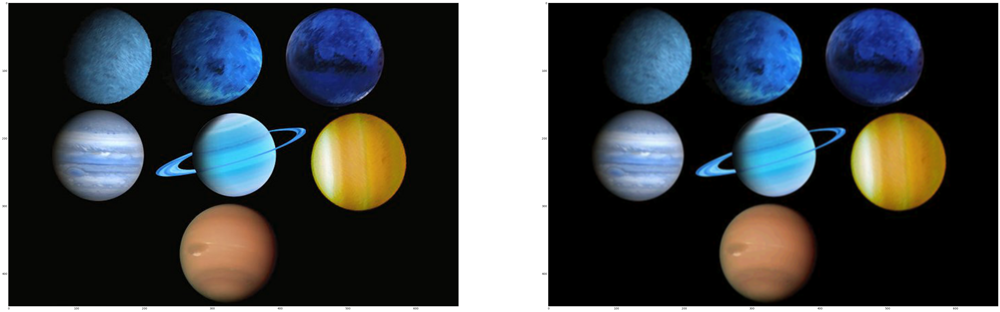

In [8]:
def convol(image,kernal,size):
    result = np.zeros((image.shape[0],image.shape[1],3), 'uint8')
    for i in range(int(size/2),image.shape[0]-int(size/2)):
        for j in range(int(size/2),image.shape[1]-int(size/2)):
            for k in range(0,size):
                for l in range(0,size):
                    result[i,j,0] += int(image[i+k-int(size/2),j+l-int(size/2),0] * kernal[k][l])
                    result[i,j,1] += int(image[i+k-int(size/2),j+l-int(size/2),1] * kernal[k][l])
                    result[i,j,2] += int(image[i+k-int(size/2),j+l-int(size/2),2] * kernal[k][l])
    return result

kernal = np.array([[1/9,1/9,1/9],[1/9,1/9,1/9],[1/9,1/9,1/9]])

average = convol(img,kernal,3) #np.zeros((img.shape[0],img.shape[1],3), 'uint8')

print(average.shape,'average')


fig, axs = subplots(1, 1, figsize=(64, 64))
#axs[0].imshow(img)
#axs[0].axis('on')
axs[0].imshow(average)
axs[0].axis('on')
gray()
show()

(448, 663, 3) Laplacian


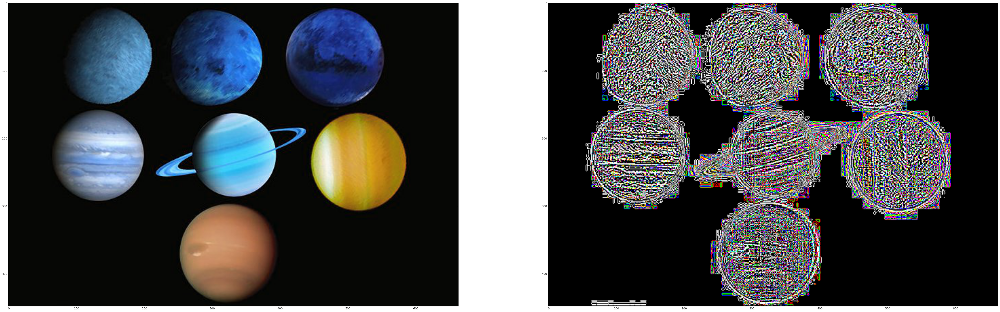

In [9]:
kernal_laplacian = np.array([[1,1,1],[1,-8,1],[1,1,1]])
kernal_laplacian2 = np.array([[0,-1,0],[-1,4,-1],[0,-1,0]])
laplacian  = convol(img,kernal_laplacian2,3)

print(laplacian.shape,'Laplacian')

fig, axs = subplots(1, 2, figsize=(64, 64))
#axs[0].imshow(img)
#axs[0].axis('on')
axs[0].imshow(laplacian)
axs[0].axis('on')
gray()
show()

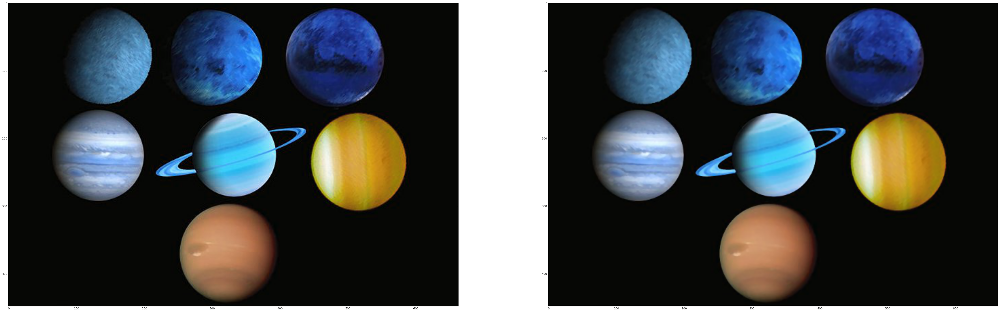

In [22]:
def bubble_sort(random_list):    
    for start_index in range( len(random_list)-1 ):
        for index in range( 1, len(random_list) - start_index ):
            if random_list[index-1] > random_list[index]:
                temp = random_list[index-1]
                random_list[index-1] = random_list[index]
                random_list[index] = temp
                
    return random_list[int(len(random_list)/2)]

median  = np.zeros((img.shape[0],img.shape[1],3), 'uint8')

median_array = np.zeros((3,9), 'uint8')

for i in range(1,median.shape[0]-1):
    for j in range(1,median.shape[1]-1):
        cnt = 0
        for k in range(0,3):
            for l in range(0,3):
                median_array[0,cnt]=img[i+k-1,j+l-1,0]
                median_array[1,cnt]=img[i+k-1,j+l-1,1]
                median_array[2,cnt]=img[i+k-1,j+l-1,2]
                cnt = cnt+1
                      
        median[i,j,0] = bubble_sort(median_array[0])
        median[i,j,1] = bubble_sort(median_array[1])
        median[i,j,2] = bubble_sort(median_array[2])

fig, axs = subplots(1, 2, figsize=(64, 64))
axs[0].imshow(img)
axs[0].axis('on')
axs[1].imshow(median)
axs[1].axis('on')
gray()
show()

(448, 663, 3) Max


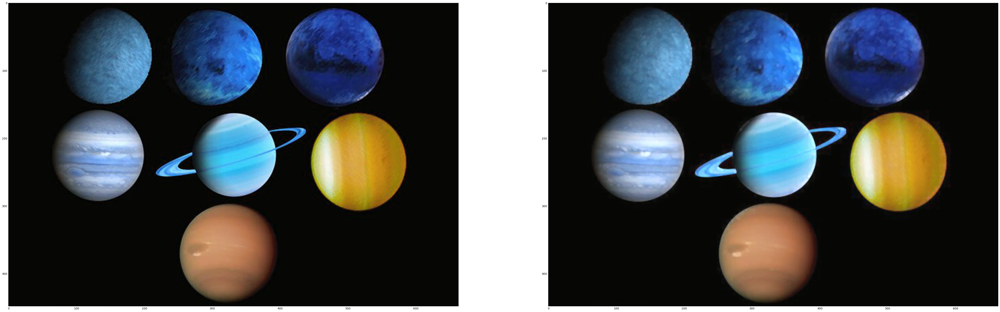

In [23]:
Max_img  = np.zeros((img.shape[0],img.shape[1],3), 'uint8')

maxs = np.zeros((3), 'uint8')
print(Max_img.shape,'Max')

for i in range(1,Max_img.shape[0]-1):
    for j in range(1,Max_img.shape[1]-1):
        maxs[0] = 0
        maxs[1] = 0
        maxs[2] = 0
        
        for k in range(0,3):
            for l in range(0,3):
                if(maxs[0] < img[i+k-1,j+l-1,0]): maxs[0] = img[i+k-1,j+l-1,0]
                if(maxs[1] < img[i+k-1,j+l-1,1]): maxs[1] = img[i+k-1,j+l-1,1]
                if(maxs[2] < img[i+k-1,j+l-1,2]): maxs[2] = img[i+k-1,j+l-1,2]
                      
        Max_img[i,j,0] = maxs[0]
        Max_img[i,j,1] = maxs[1]
        Max_img[i,j,2] = maxs[2]

fig, axs = subplots(1, 2, figsize=(64, 64))
axs[0].imshow(img)
axs[0].axis('on')
axs[1].imshow(Max_img)
axs[1].axis('on')
gray()
show()

(448, 663, 3) Min


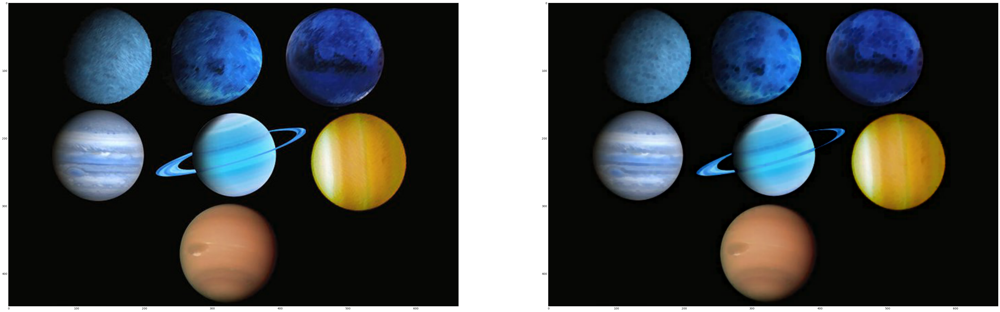

In [2]:
Min  = np.zeros((img.shape[0],img.shape[1],3), 'uint8')

mins = np.zeros((3), 'uint8')

print(Min.shape,'Min')

for i in range(1,Min.shape[0]-1):
    for j in range(1,Min.shape[1]-1):     
        mins[0] = 255
        mins[1] = 255
        mins[2] = 255
        
        for k in range(0,3):
            for l in range(0,3):
                if(mins[0] > img[i+k-1,j+l-1,0]): mins[0] = img[i+k-1,j+l-1,0]
                if(mins[1] > img[i+k-1,j+l-1,1]): mins[1] = img[i+k-1,j+l-1,1]
                if(mins[2] > img[i+k-1,j+l-1,2]): mins[2] = img[i+k-1,j+l-1,2]
                      
        Min[i,j,0] = mins[0]
        Min[i,j,1] = mins[1]
        Min[i,j,2] = mins[2]

fig, axs = subplots(1, 2, figsize=(64, 64))
axs[0].imshow(img)
axs[0].axis('on')
axs[1].imshow(Min)
axs[1].axis('on')
gray()
show()